# Project: Explore Braun dataset


__Upstream Steps__

* Assemble adata
* Filtered to select cortex, cerebellum, thalamus
* Sub-sampled to 75000 cells


__This notebook__

* QC filter on cells
* Expression filter on genes
* Normalization and log10 transformation by Scanpy functions
* Feature selection (HVG) by Scanpy functions
* Dimensionality reduction
* Batch correction by Harmony



# Dataset Information

## References

* [Paper Reference: Comprehensive cell atlas of the first-trimester developing human brain](https://www.science.org/doi/10.1126/science.adf1226)
* [Data and code repository: GitHub Repo](https://github.com/linnarsson-lab/developing-human-brain)


> Short description: 26 brain specimens spanning 5 to 14 postconceptional weeks (pcw) were dissected into 111 distinct biological samples. Each sample was subjected to single-cell RNA sequencing, resulting in 1,665,937 high-quality single-cell


__Subsample of the dataset selecting cortex, cerebellum and thalamus__

<div class="alert alert-block alert-info"><b>Cell populations identified by the authors:</b> 

* __Erythrocyte__
* __Fibroblast__
* __Glioblast__
* __Immune__
* __Neural crest__
* __Neuroblast__
* __Neuron__
* __Neuronal IPC__
* __Oligo__
* __Placodes__
* __Radial glia__
* __Vascular__

-----

# 1. Environment

In [1]:
import scanpy as sc, anndata as ad, numpy as np, pandas as pd
import warnings
import yaml
import os
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.sparse as sp
import statsmodels.api as sm
import scanpy as sc
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans

import matplotlib.pyplot 
import warnings
warnings.filterwarnings('ignore')

from scipy import stats
warnings.filterwarnings('ignore')
import plotly.express as px
import plotly.io as pio
import itertools
import sys
pio.renderers.default = "jupyterlab"

import random
random.seed(1)

In [2]:
homeDir = os.getenv("HOME")

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()


# import user defined functions from the utils folder
import matplotlib.pyplot as plt
sys.path.insert(1, "../2_Day2/utils")

from CleanAdata import *
from SankeyOBS import *

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.2 igraph==0.11.5 pynndescent==0.5.12


## 1.3 Input file

You can set parameters useful for your analysis in the cells below and then recall them during the analysis

In [3]:
path = '../DataDir/InputData/'
Id = 'Project_FiltNormAdata.h5ad'
input_file = path + Id

----

# 1. Data Load


In [4]:
adata = sc.read_h5ad(input_file)
adata.var_names_make_unique()

# 2. Additional QCs

Here we perform few additional inspections to ensure to avoid technical issues being carried over to the next steps. 

First we compute again the quality metrics:

In [5]:
# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata.var["mt"] = adata.var_names.str.startswith("MT-")
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))

# hemoglobin genes
adata.var["hb"] = adata.var_names.str.contains("^HB[^(P)]")

sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

In [6]:
# Format better Donor and Week columns
adata.obs["Og_Donor"] = adata.obs["Og_Donor"].str.replace(":","")
adata.obs["Og_Week"] = adata.obs["Og_Week"].astype("string")

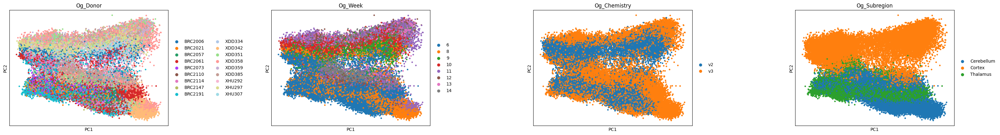

In [7]:
sc.pl.pca(adata, color=["Og_Donor", "Og_Week","Og_Chemistry","Og_Subregion"], ncols=4, wspace=.5, size = 50, vmin='p1', vmax='p99')

## 2.4 Batches inspection

In [8]:
adata.obs

,Og_Subregion,Og_Tissue,Og_TopLevelCluster_x,Og_dissection,Og_Donor,Og_Age,Og_Week,Og_Chemistry,run_id,sample_id,...,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,total_counts_hb,log1p_total_counts_hb,pct_counts_hb
CellID_Index,,,,,,,,,,,,,,,,,,,,,
b'10X208_6:ACGGTCGCAGTCAGTT',Cortex,Occipital_cortex,2,Occipital_cortex,XDD358,11.5,11,v3,NoInfo,10X208_6,...,4.429574,8.076678,13.885225,26.650324,22.181249,3.143344,0.541272,1.102416,0.743087,0.026901
b'10X212_6:GTGCTGGTCTTTCAGT',Cortex,Lower_cortex,0,Lower_cortex,XDD359,13.0,13,v3,NoInfo,10X212_6,...,4.607994,8.334671,14.549377,28.904248,25.100336,3.261948,0.646785,1.425516,0.886044,0.036733
b'10X89_6:ACTTTCACAAACTGCT',Thalamus,Thalamus,13,Thalamus,BRC2006,8.0,8,v2,NoInfo,10X89_6,...,6.697738,12.189211,21.691530,44.923577,23.801810,3.210917,0.891311,1.789264,1.025778,0.067003
b'10X199_8:CTAAGTGAGCTATCTG',Thalamus,Thalamus,13,Thalamus,BRC2191,6.9,6,v3,NoInfo,10X199_8,...,4.537666,8.189201,14.390066,29.213019,29.283055,3.410588,0.768188,0.933989,0.659585,0.024502
b'10X199_5:TACCTGCGTAAGATTG',Thalamus,Thalamus,34,Thalamus,BRC2191,6.9,6,v3,NoInfo,10X199_5,...,5.401125,9.620665,16.112945,30.466863,31.569998,3.483392,0.877779,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
b'10X156_1:CAAGAAAGTCTAGTGT',Cerebellum,Cerebellum,9,Cerebellum,XDD334,8.0,8,v2,NoInfo,10X156_1,...,5.977457,10.746987,18.915256,39.211040,11.394504,2.517253,0.376367,0.000000,0.000000,0.000000
b'10X254_7:CACTAAGTCGTCAGAT',Thalamus,Thalamus,38,Thalamus,XDD385,14.0,14,v3,NoInfo,10X254_7,...,4.178680,7.443501,13.039368,26.484720,33.267573,3.534200,0.827652,1.797263,1.028642,0.044713
b'10X102_4:GCGCAGTCATTTCACT',Cortex,Cortex,28,Cortex,XHU297,10.0,10,v2,NoInfo,10X102_4,...,6.114603,10.842398,17.966865,34.507028,21.706862,3.122667,0.670763,1.065353,0.725301,0.032920


In [9]:
plotSankey(adata, covs=["Og_Donor","Og_Subregion","Og_Chemistry","sample_id"])

## 2.2. Multiplets inspection via scDblFinder

<div style="padding-top: 10px; font-size: 15px;">
Up until now, we never inspected for multiplets in our dataset, for this reason we'll use the well established <a href="https://github.com/plger/scDblFinder"> scDblFinder</a>. The concept behind this tool is a detetection of doublets or multiplets through a two-step approach:

* Generation of in silico doublets
* kNN classification of initial cells based on the in silico doublets

In [11]:

import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
anndata2ri.activate()
%load_ext rpy2.ipython
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

import os
from rpy2 import robjects

# Set R_HOME and R_LIBS_USER
# Set R_HOME and R_LIBS_USER
# Set R_HOME and R_LIBS_USER
os.environ['R_HOME'] = '/opt/R/4.3.1/lib/R/bin//R'
os.environ['R_LIBS_USER'] = '/opt/R/4.3.1/lib/R/library'
from rpy2 import robjects
custom_lib_paths = "/opt/R/4.3.1/lib/R/library"
robjects.r(f'.libPaths(c("{custom_lib_paths}", .libPaths()))')


# Clean anndata from unnecessary fields
# Clean anndata from unnecessary fields
# Clean anndata from unnecessary fields
if os.path.isfile("./utils/DoubletCLass.tsv"):
    print("Loading precomputed dbls class")
    dblfinderClass = pd.read_csv("./utils/DoubletCLass.tsv", sep="\t", index_col=0)
    adata.obs['scDblFinder.classs'] = dblfinderClass
else:
    dblfinderClass = pd.DataFrame()
    for sample in adata.obs["sample_id"].unique():
        print(sample)
        sce = adata[adata.obs["sample_id"] == sample].copy()
        sce = sce.copy()
        sce.obs = sce.obs[["sample_id"]]
        del sce.obsp
        sce.layers["counts"] = sce.layers["counts"].astype(np.int32).todense()
        sce.X = sce.layers["counts"].copy()
        sce = sce.copy()

        del sce.obsm
        del sce.varm
        del sce.uns
        sce.var.index.name = None
        sce.var = sce.var[["EnsembleCode"]]
        # Run doublets detection
        # Run doublets detection
        # Run doublets detection

        sce = anndata2ri.py2rpy(sce)
        print(sce)
        scDblFinder = rpy2.robjects.packages.importr('scDblFinder')
        S4Vectors = rpy2.robjects.packages.importr('S4Vectors')

        as_data_frame = rpy2.robjects.r['as.data.frame']
        sce = scDblFinder.scDblFinder(sce)
        dblfinderClass = pd.concat([dblfinderClass,sce.obs[["scDblFinder.class"]]])
        #SingletsList.extend(sce.obs["scDblFinder.class"].tolist())
        del sce
    dblfinderClass["scDblFinder.class"].to_csv("./utils/DoubletCLass.tsv", sep="\t")


# Save doublets info column
#sce.obs["scDblFinder.class"].to_csv("...", sep="\t")


The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython
Loading precomputed dbls class


In [13]:
adata.obs = pd.concat([adata.obs, dblfinderClass], axis = 1).loc[adata.obs.index]
adata = adata[adata.obs["scDblFinder.class"] == "singlet"]

## 2.3 Additional filtering

For downstream analysis we want to be more conservative, so we inspect the relationship between the percentage of mitochondrial genes and the number of genes detected in each cell to identify outliers:

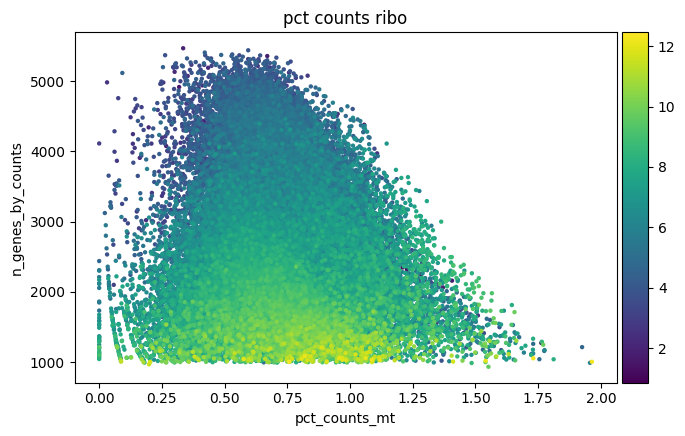

In [14]:
# refine filtering

sc.pl.scatter(adata, x="pct_counts_mt",y="n_genes_by_counts", size=40, color="pct_counts_ribo")


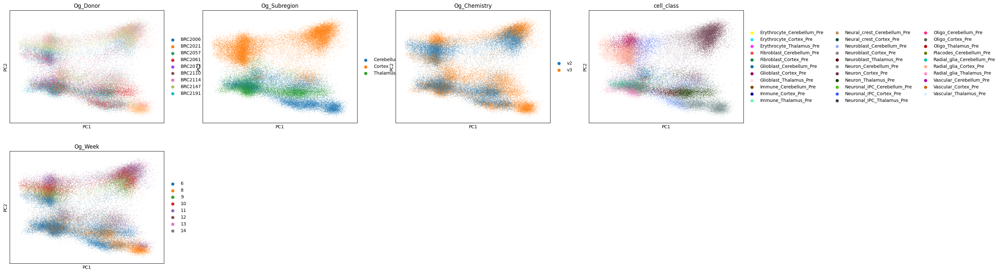

In [15]:
sc.pl.pca(adata, color=["Og_Donor","Og_Subregion","Og_Chemistry","cell_class","Og_Week"])

We can see that cells with a low number of genes have higher percentage of mitochondrial and ribosomal genes, so we filter out those:

In [16]:
adata = adata[adata.obs["n_genes_by_counts"] >= 2000]

### 2.4.1 PCA regressors to check variance associated with covariates

A useful assessment consists in understanding how much of the variability of the PCA is explained by the covariates (**"Donor_region","Auth_Batch","Auth_Assay_formatted","Auth_Age","cell_label"**). We can use [Ordinary Least Squares regression]("https://www.statsmodels.org/dev/generated/statsmodels.regression.linear_model.OLS.html") on principal component (PC) embeddings and plot the residuals for specific covariates. This will help us understand whether for a specific principal component and a specific covariates, we observe differences across the values of the covariate. This will highlight covariates and batches that may impact the PC and answer the question __"How much technical and biological factors guide the dimensionality reduction?"__

In [17]:
import matplotlib.pyplot as plt
from statsmodels.formula.api import ols


def plotResiduals(adata, covToTest, npcs):
    PCRegrDict = {}
    sns.set_theme(style="ticks")
    varianceSummary = pd.DataFrame()
    
    for i in range(npcs):
        
        for n,c in enumerate(covToTest):
            # format the data
            Dummies = pd.get_dummies(adata.obs[c])
            PCRegr = (Dummies.T * adata.obsm["X_pca"][:,i].T).T.melt()
            PCRegr = PCRegr[PCRegr["value"] != 0]
            PCRegr["variable"] = PCRegr["variable"].astype("category")
            PCRegr["cov"] = c
            PCRegrDict["PC:{}_COV:{}".format(i+1,c)] = PCRegr.copy()
            sns.despine(offset=30)
            PCRegrModel = pd.get_dummies(PCRegrDict["PC:{}_COV:{}".format(i+1,c)], "variable").copy()
            
            # define the regression formula
            formula = "".join(["value ~ "," + ".join(["C("+c+")" for c in PCRegrModel.columns[1:-1].tolist()])])
            
            # fit the regression
            fit = ols(formula, data=PCRegrModel).fit() 
            # fit.rsquared_adj
            
            # get the residuals
            PCRegr["rsquared_adj"] = fit.rsquared_adj
            PCRegr["PC"] = i
            varianceSummary = pd.concat([varianceSummary,PCRegr ], ignore_index=True)
            
    CovOrder = {i:varianceSummary.drop_duplicates(["PC","cov"])[varianceSummary.drop_duplicates(["PC","cov"])["PC"] == i].sort_values("rsquared_adj", ascending=False)["cov"].tolist() for i in varianceSummary["PC"].unique().tolist()}
    
    for i in range(npcs):
        fig, axes = plt.subplots(1,len(covToTest), figsize=(40,4), dpi=300, sharex=False,sharey=False)
        plt.subplots_adjust(wspace=.5)
		#adata.obsm["X_pca"]
        
        for n,c in enumerate(CovOrder[i]):
            PCRegr = varianceSummary[(varianceSummary["PC"] == i) & (varianceSummary["cov"] == c)]
            sns.boxplot(data=PCRegr, x="variable", y="value", ax = axes[n],whis=[0, 100],
                        palette={i:adata.uns[c+"_colors"][adata.obs[c].cat.categories.tolist().index(i)] for i in PCRegr["variable"].unique().tolist()}
                        #order=[i for i in PlotOrder[c] if i in PCRegr["variable"].unique().tolist()],
                        #hue_order=[i for i in PlotOrder[c] if i in PCRegr["variable"].unique().tolist()])
                       )
            sns.stripplot(data=PCRegr, x="variable", y="value", size=4, color=".3",ax = axes[n], 
                          #order=[i for i in PlotOrder[c] if i in PCRegr["variable"].unique().tolist()],
                          #hue_order=[i for i in PlotOrder[c] if i in PCRegr["variable"].unique().tolist()])
                         )
            axes[n].title.set_text('Covariate:{}'.format(c))
            axes[n].set_xlabel(c, fontsize=20)
            axes[n].set_ylabel("PC{} embeddings".format(i+1), fontsize=20)
            sns.despine(offset=30)
            fit.rsquared_adj = PCRegr["rsquared_adj"].values[0]
            axes[n].text(0.5, 0, "rsquared_adj:{}".format(round(fit.rsquared_adj,2)), horizontalalignment='center', verticalalignment='center',transform=axes[n].transAxes)
            axes[n].tick_params(axis="x", rotation=45)
            plt.xticks(rotation=45)
            fig.autofmt_xdate(rotation=45)

<Figure size 640x480 with 0 Axes>

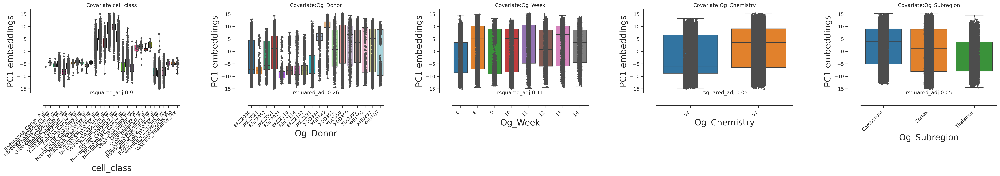

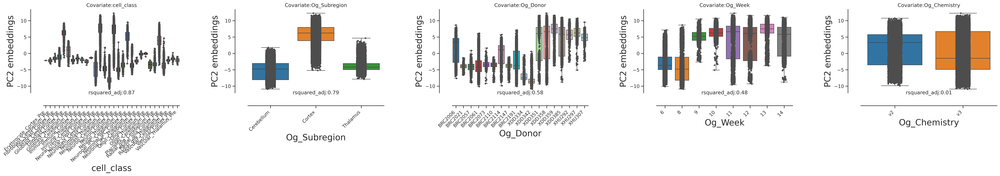

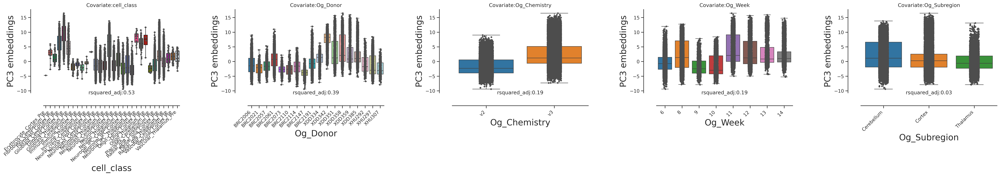

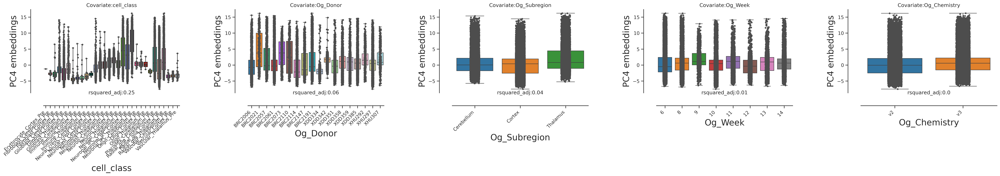

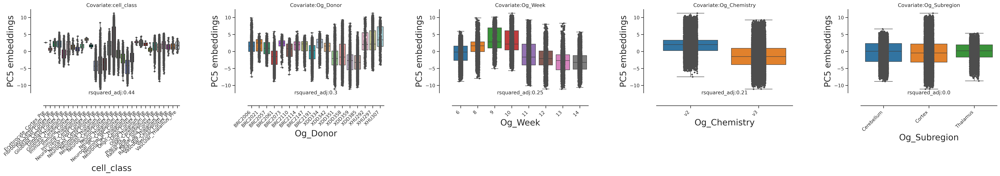

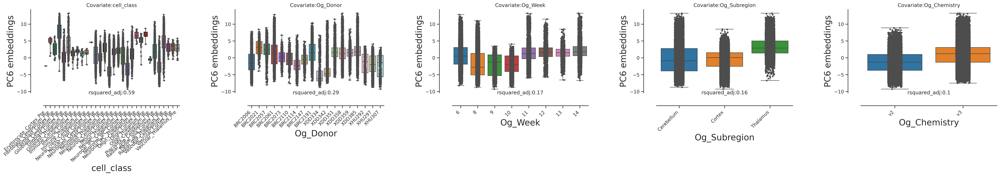

In [18]:
npcs = 6
covToTest = ["Og_Donor","Og_Subregion","Og_Chemistry","cell_class","Og_Week"]

plotResiduals(adata, covToTest, npcs)

# 3. kNN-based metacells aggregation


## 3.1 Data preparation 

In [19]:


BadCelltypes = ["Immune_Cortex_Pre",
"Vascular_Cortex_Pre",
"Immune_Cerebellum_Pre",
"Vascular_Cerebellum_Pre",
"Vascular_Thalamus_Pre",
"Fibroblast_Cortex_Pre",
"Fibroblast_Cerebellum_Pre",
"Immune_Thalamus_Pre",
"Erythrocyte_Cortex_Pre"]
BadCelltypes = '|'.join(BadCelltypes)


adata = adata[~adata.obs.cell_class.str.contains(BadCelltypes)]



## 3.2 Metacells definition and aggregation

We propose a method that follows these steps:

* First of all, before the aggregation, we need to define the kNN graph and its parameter. We can tune it by defining the number of __Highly Variable Genes__ used for __Principal Component Analysis__ and, of those, decide how many will be used to compute the distance between the cells. Since we are computing a kNN, we will need to decide the __number of neighbours (k)__ to which a cell will be connected to.

* For __each sample__, we compute the __kNN graph__ with Scanpy's function `sc.pp.neighbors`

* The computed connectivities will be used as values to cluster the cells by applying a [__kMeans clustering__ (https://scikit-learn.org/1.5/modules/clustering.html#k-means) and taking the average normalized expression value of each gene in each cluster. We save these values in a new AnnData object, which .X matrix will be metacells x genes and __concatenate the results for all the samples__. Here we set 400 metacells for each sample and we have 6 samples, so we'll have 3200 metacells in the end.

* We __assign a label__ to each cluster based on the the most common cell label for each cluster


<span style="color: red; font-size: 15px;"> **What impact do you expect to have the change of the initial number of highly variable genes?**

<details>
<summary> Hints </summary>
<dl>
<dt>A higher number of highly variable genes will:</dt>
    <dd>- increase the computational burden</dd>
    <dd>- increase the risk of including genes that are not useful to define differences across cells (ex. genes that are in common to more cell types or are widely expressed)</dd>
    <dd>- increase the risk of having less pure metacells (ex. composed of a mix of cells from different cell types)</dd>
</dl>

<dl>
<dt>A lower number of highly variable genes will:</dt>
    <dd>- decrease the computational burden</dd>
    <dd>- increase the risk of excluding useful genes for the definition of a particular cell state</dd>
    <dd>- increase the risk of not capturing rarer cell types with the clusters defined</dd>
</dl>
</details>

<span style="color: red; font-size: 15px;"> **What impact do you expect to have the change of the initial number of principal components?**

<details>
<summary> Hints </summary>
<dl>
<dt>Including a higher number of principal components will:</dt>
    <dd>- increase the computational burden</dd>
    <dd>- increase the risk of including PC which variance is driven by technical variation</dd>
    <dd>- increase the risk of metacells to be representative of a batch and not of the cell states</dd>
</dl>

<dl>
<dt>Including a lower number of principal components will:</dt>
    <dd>- decrease the computational burden</dd>
    <dd>- increase the risk of including PC which variance is driven by technical variation</dd>
    <dd>- increase the risk of capturing not enough complexity and loosing rarer cell states</dd>
</dl>

</details>

In [42]:
adata = adata[adata.obs["Og_Subregion"] == "Cortex"]

In [43]:
adata.obs["Donor_region"] = adata.obs["Og_Donor"].astype("str")+"_"+adata.obs["Og_Subregion"].astype("str")

In [64]:
NewAdataList = []

import os
os.environ["OMP_NUM_THREADS"] = "4"
n_neighbors = 30
n_pcs = 8
n_top_genes = 2000
n_clusters = 500


if not os.path.exists("./utils/kmeansAggregation/"):
    os.makedirs("./utils/kmeansAggregation/")

for sample in adata.obs["Donor_region"].unique().tolist():
    print(sample)
    adataLocal = adata[adata.obs["Donor_region"] == sample].copy()
    if adataLocal.shape[0] <= 700:
        continue
    ncells = adataLocal.shape[0]
    filenameBackup = "./utils/kmeansAggregation/Kmeans{}.{}.{}topgenes.{}neighbs.{}pcs.{}Ks.csv".format(ncells,sample,n_top_genes,n_neighbors,n_pcs,n_clusters )
    
    # Check if the kmeans was precomputed
    if os.path.isfile(filenameBackup):
        print("Retrieving precomputed kmeans classes \n")
        KmeansOBS = pd.read_csv(filenameBackup, sep="\t", index_col=0)
        adataLocal.obs['kmeans_clusters'] = KmeansOBS
    else:
        #If not run k-means metacells aggregation
        sc.pp.highly_variable_genes(adataLocal, n_top_genes=n_top_genes, flavor="seurat")
        sc.tl.pca(adataLocal)
        # Step 1: Compute the KNN graph
        sc.pp.neighbors(adataLocal, n_neighbors = n_neighbors , transformer='pynndescent', n_pcs=n_pcs, metric="euclidean")  # Adjust n_neighbors as needed
        # Step 2: Extract the connectivity matrix from AnnData
        connectivities = adataLocal.obsp['distances'].toarray()
        
        # Step 3: Apply K-Means clustering with a fixed number of clusters
        print("Computing kmeans")
        adataLocal.obs['kmeans_clusters'] = KMeans(n_clusters=n_clusters, random_state=0).fit_predict(connectivities)
        print("Storing kmeans classes \n")
        adataLocal.obs["kmeans_clusters"].to_csv(filenameBackup, sep="\t")

    
    adataLocal.X = adataLocal.layers["counts"].copy()

    # Normalize counts
    sc.pp.normalize_total(adataLocal, target_sum=2e4)

    # Create combined AnnData objects efficiently and add to NewAdataList
    # Step 2: Create dummy variables for clusters
    dummy_clusters = pd.get_dummies(adataLocal.obs['kmeans_clusters'])

    # Step 3: Dot product for mean aggregation of expression values
    # Each column in `cluster_aggregated_X` represents mean expression for a cluster
    X_dense = adataLocal.X.A if hasattr(adataLocal.X, "A") else adataLocal.X
    cluster_aggregated_X = dummy_clusters.T.dot(X_dense)

    cluster_aggregated_median_X = np.zeros((dummy_clusters.shape[1], X_dense.shape[1]))
    for cluster_idx in range(dummy_clusters.shape[1]):
        # Select cells belonging to the current cluster
        cluster_cells = X_dense[dummy_clusters.iloc[:, cluster_idx].values == 1]
        # Compute the median across cells within the cluster
        cluster_aggregated_median_X[cluster_idx, :] = np.median(cluster_cells, axis=0)

    # Convert to AnnData structure
    adataAggregated = ad.AnnData(X=cluster_aggregated_X)
    adataAggregated.layers["median"] = cluster_aggregated_median_X # we save an additional layer having as aggregated value the median of the gene expression
    adataAggregated.var_names = adataLocal.var_names
    adataAggregated.obs['kmeans_clusters'] = dummy_clusters.columns

    # Step 4: Aggregating labels and metadata
    # Get the most common cell label for each cluster
    adataAggregated.obs['AggregatedClass'] = (
        adataLocal.obs.groupby('kmeans_clusters')['cell_class']
        .agg(lambda x: x.value_counts().idxmax())
        .reindex(dummy_clusters.columns)
        .values
    )
    adataAggregated.obs['AggregatedLabel'] = (
        adataLocal.obs.groupby('kmeans_clusters')['cell_label']
        .agg(lambda x: x.value_counts().idxmax())
        .reindex(dummy_clusters.columns)
        .values
    )
    adataAggregated.obs_names = list(sample+"_"+adataAggregated.obs["kmeans_clusters"].astype(str))
    # Assign metadata fields with identical values across each cluster
    for obsMD in [col for col in adataLocal.obs.columns if len(adataLocal.obs[col].unique()) == 1]:
        adataAggregated.obs[obsMD] = adataLocal.obs[obsMD].iloc[0]

    # Add the aggregated AnnData to NewAdataList
    NewAdataList.append(adataAggregated)

XDD358_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)
XDD359_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)
XHU297_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)
XDD385_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)
BRC2114_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)
BRC2061_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)
XHU292_Cortex
XHU307_Cortex
BRC2006_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)
BRC2191_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)
XDD351_Cortex
Retrieving precomputed kmeans classes 

normalizing counts per cell
    finished (0:00:00)


# Save

In [65]:
# Save the new aggregated anndata
from scipy import sparse
CombinedAdata = ad.concat(NewAdataList)
# Conevert to sparse matrix
CombinedAdata.X = sparse.csr_matrix(CombinedAdata.X)
CombinedAdata.layers["median"] = sparse.csr_matrix(CombinedAdata.layers["median"])

In [66]:
print(adata.shape)

(23475, 15077)


In [67]:
print(CombinedAdata.shape)

(4500, 15077)


In [68]:
CombinedAdata.write_h5ad("./1_CombinedMetaCells.h5ad")

# Re process

In [69]:
n_neighb = 60
n_pcs = 10

CombinedAdata = ad.concat(NewAdataList)
# Keep only clusters with at least 10 cells
AggregatedOBS = CombinedAdata.obs["AggregatedLabel"].value_counts().loc[CombinedAdata.obs["AggregatedLabel"].value_counts() > 100].index.tolist()
CombinedAdata = CombinedAdata[CombinedAdata.obs["AggregatedLabel"].isin(AggregatedOBS)]


In [70]:
import scvelo as scv
scv.tl.score_genes_cell_cycle(CombinedAdata)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    598 total control genes are used. (0:00:01)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    558 total control genes are used. (0:00:00)
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


normalizing counts per cell


    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    with n_comps=50
    finished (0:00:00)


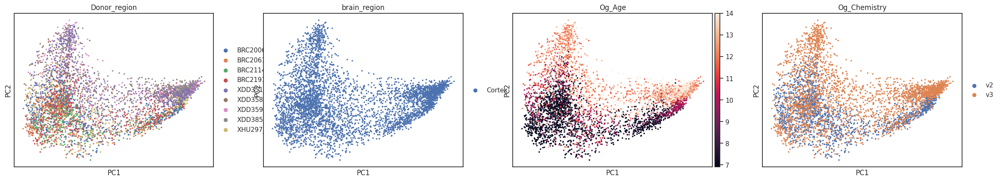

In [71]:
sc.pp.normalize_total(CombinedAdata, target_sum=2e4)
sc.pp.log1p(CombinedAdata)
sc.pp.highly_variable_genes(CombinedAdata, n_top_genes=2000, flavor="seurat", batch_key="Donor_region")
sc.pp.pca(CombinedAdata)
sc.pl.pca(CombinedAdata,color=["Donor_region","brain_region","Og_Age","Og_Chemistry"])

In [72]:
plotSankey(CombinedAdata, covs=["Donor_region","Og_Age","Og_Chemistry"])

In [73]:
HVGs = []
for i in CombinedAdata.obs["Og_Chemistry"].unique():
    CombinedAdataKIT = CombinedAdata[CombinedAdata.obs["Og_Chemistry"] == i]
    MinBatches = 2
    sc.pp.highly_variable_genes(CombinedAdataKIT, n_top_genes=2000, flavor="seurat", batch_key="Og_Donor")
    kitHVGs = CombinedAdataKIT.var_names[CombinedAdataKIT.var["highly_variable_nbatches"] >= 2 ].tolist()
    print(len(kitHVGs))
    HVGs.extend(kitHVGs)
    #sc.pp.hig (CombinedAdataKIT, batch_key="MinBatches", flavour="seurat")
print(len(set(HVGs)))

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
2731
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
1453
2998


computing PCA
    with n_comps=50
    finished (0:00:01)


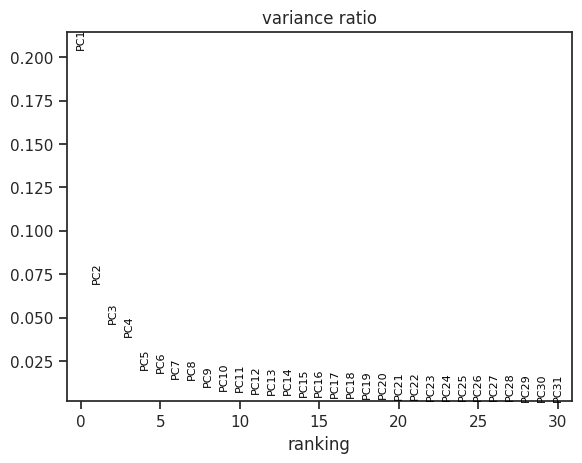

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


In [74]:

CombinedAdata.var["highly_variable"] = CombinedAdata.var_names.isin(HVGs)
sc.tl.pca(CombinedAdata)
sc.pl.pca_variance_ratio(CombinedAdata)
sc.pp.neighbors(CombinedAdata, n_neighbors=n_neighb, n_pcs=n_pcs, metric="euclidean")
sc.tl.umap(CombinedAdata)


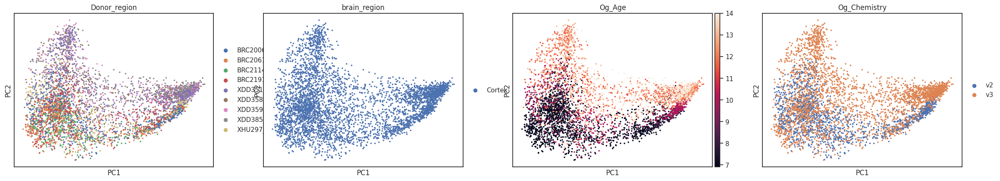

In [75]:
sc.pl.pca(CombinedAdata, color=["Donor_region","brain_region","Og_Age","Og_Chemistry"])

<div class="alert alert-block alert-warning"><b>NOTE on HVGs</b>

**We specify:**

```
sc.pp.highly_variable_genes(CombinedAdata, n_top_genes=2000, flavor="seurat", **batch_key="Donor_region"**)
CombinedAdata.var["highly_variable"] = CombinedAdata.var["highly_variable_nbatches"] **>= 2**
```

 Because we want to employ ony highly variable genes deriving from at **least 2 samples**, so to avoid including HVG exclusive for a specific batch.

<span style="color: red; font-size: '4';"> **What are your observations about the distribution of markers and distribution of batches?**

## 1.3 Perform a fresh integration on the new metacells anndata

<div class="alert alert-block alert-info">
<font size="3">After steps that involve alteration of the relationships among cells consider re-computing **PCA/Neighbors and/or HVGs** , e.g.:<b>NOTE: Pre-processing</b>

<font size="3">After steps that involve alteration of the relationships among cells consider re-computing **PCA/Neighbors and/or HVGs** , e.g.:

* `Integration`
* `Filtering`
* `Subsetting`

In [76]:
import scanpy.external as sce

CombinedAdata = CleanAdata(CombinedAdata, obstokeep=CombinedAdata.obs.columns.tolist(), obsmtokeep="X_pca")
sce.pp.harmony_integrate(CombinedAdata, key="Og_Chemistry", max_iter_harmony=20)

2024-11-14 14:04:28,245 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-11-14 14:04:30,067 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-11-14 14:04:30,084 - harmonypy - INFO - Iteration 1 of 20
2024-11-14 14:04:30,823 - harmonypy - INFO - Iteration 2 of 20
2024-11-14 14:04:31,536 - harmonypy - INFO - Iteration 3 of 20
2024-11-14 14:04:32,266 - harmonypy - INFO - Iteration 4 of 20
2024-11-14 14:04:33,005 - harmonypy - INFO - Iteration 5 of 20
2024-11-14 14:04:33,770 - harmonypy - INFO - Iteration 6 of 20
2024-11-14 14:04:34,477 - harmonypy - INFO - Iteration 7 of 20
2024-11-14 14:04:35,202 - harmonypy - INFO - Converged after 7 iterations


<font size="4"> In this case __force-directed graph__ can be an useful visualization tool that better capture relationships among cells (i.e., lineages). It is a different low-dimensional representation of the data which algorithm where similarities and differences between cells are forces that drives the distribution of cells in space, maximizing the distance between cells that are different (which will "repulse" each other) and minimizing the one between similar cells. For reference: [Scanpy's API](https://scanpy.readthedocs.io/en/stable/generated/scanpy.tl.draw_graph.html)

In [ ]:
sc.pp.neighbors(CombinedAdata, n_neighbors=n_neighb, n_pcs=n_pcs, use_rep="X_pca_harmony")
sc.tl.umap(CombinedAdata)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:25)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.99705535 0.9886424  0.9845436  0.9821526  0.97895366
     0.9762703  0.9729759  0.96282446 0.96047276 0.95544434 0.95061105
     0.94410914 0.9394347  0.93492514]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


In [88]:
sc.tl.leiden(CombinedAdata, resolution=.5)
sc.tl.rank_genes_groups(CombinedAdata,groupby="leiden", method="wilcoxon")

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


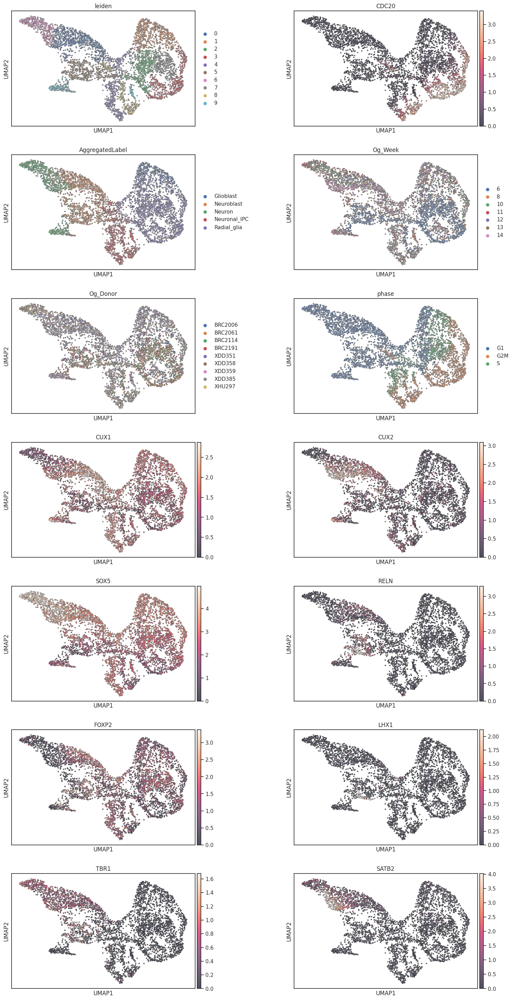

In [89]:
sc.pl.umap(CombinedAdata, color=["leiden","CDC20","AggregatedLabel","Og_Week","Og_Donor","phase","CUX1","CUX2","SOX5","RELN","FOXP2","LHX1","TBR1","SATB2"], 
              size=10, wspace=.4, ncols=2, vmin='p1', vmax='p99', 
              add_outline=True, edges=False, edges_width=.01)

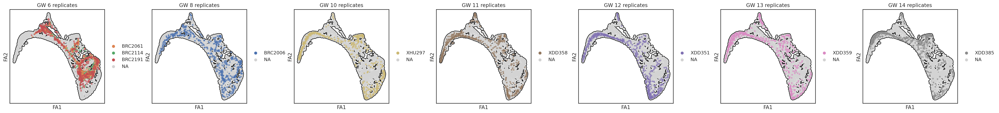

In [90]:
fig, axes = plt.subplots(1,len(CombinedAdata.obs.Og_Week.unique()), figsize=(40, 4), dpi=200)
for group in enumerate(CombinedAdata.obs.Og_Week.sort_values().unique()):
    SampleIDs = CombinedAdata.obs.loc[CombinedAdata.obs.Og_Week == group[1],"Og_Donor"].unique().tolist()
    axes[group[0]] = sc.pl.embedding(CombinedAdata, size = 60, add_outline=True,ncols=2, color=["Og_Donor"],title="GW {} replicates".format(group[1]),
                     groups=SampleIDs, vmin='p1', vmax='p99', show=False, ax=axes[group[0]], basis = "draw_graph_fa")

plt.subplots_adjust(wspace=.5)
fig.show()

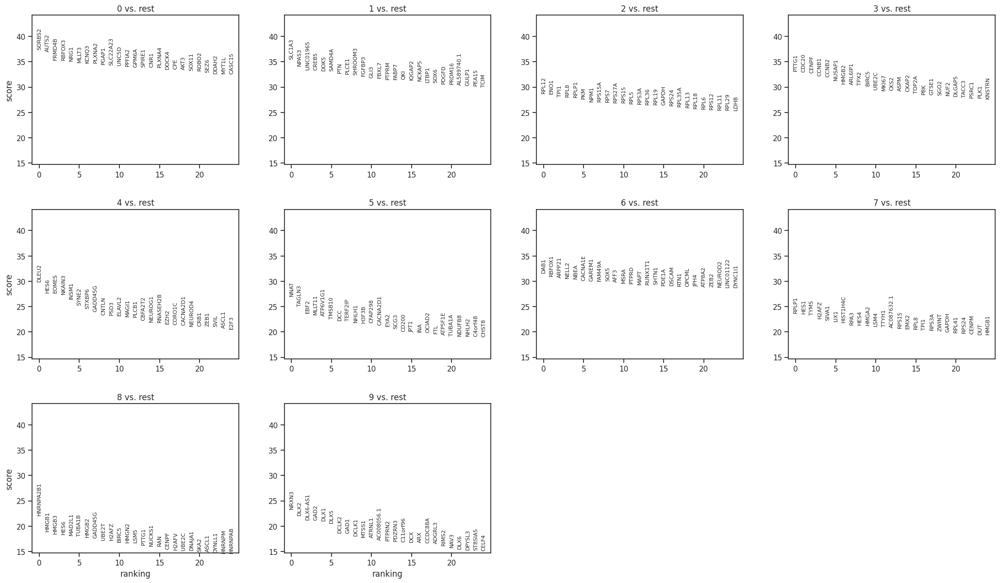

In [91]:
sc.pl.rank_genes_groups(CombinedAdata, n_genes=25, ncols=4, fontsize=8)